## Connect to your SAP HANA instance

The latest Python ML client for SAP HANA package update is ready for installation and can be found at: https://pypi.org/project/hana-ml/

In [2]:
## Loading the Python Machine Learning client library for SAP HANA and get the version
import hana_ml
print(hana_ml.__version__)

2.22.24091700


Connect using the secure user connection store (hdbuserstore) and a connection key, see  [documentation](https://help.sap.com/docs/SAP_HANA_CLIENT/f1b440ded6144a54ada97ff95dac7adf/708e5fe0e44a4764a1b6b5ea549b88f4.html).  

In [3]:
# Create the SAP HANA CLoud connection
import hana_ml.dataframe as dataframe
#cc = dataframe.ConnectionContext( address="<hana-cloud-hostname>", port=443,  user="<HANA-user>")
#cc = dataframe.ConnectionContext( userkey=<your-key-name>, sslValidateCertificate=False)

# Utilize connection credentials from external file
from hana_ml.dataframe import ConnectionContext
from hana_ml.algorithms.pal.utility import Settings
url, port, user, pwd = Settings.load_config("../../config/e2edata.ini", "api")
#cc = ConnectionContext(url, port, user, pwd)
cc = ConnectionContext(userkey='<your key>')

# Control connection
print(cc.connection.isconnected())
print(cc.hana_version())

True
2.00.080.00.1729062409 (hana2sp08)


## 2.17 Misc enhancments
###  HANA scheduler

In [7]:
from hana_ml.algorithms.pal.utility import DataSets, Settings
diabetes_full, diabetes_train, diabetes_test, _ = DataSets.load_diabetes_data(cc)

Table PIMA_INDIANS_DIABETES_TBL exists.


In [8]:
import uuid
from hana_ml.algorithms.pal.auto_ml import AutomaticClassification
from hana_ml.visualizers.automl_progress import PipelineProgressStatusMonitor

progress_id = "automl_{}".format(uuid.uuid1())
auto_c = AutomaticClassification(generations=2, 
                                 population_size=5,
                                 offspring_size=5, 
                                 progress_indicator_id=progress_id)

auto_c.disable_workload_class_check()


progress_status_monitor = PipelineProgressStatusMonitor(connection_context=cc, automatic_obj=auto_c)
progress_status_monitor.start()
auto_c.fit(diabetes_train, key="ID", label="CLASS")



<IPython.core.display.Javascript object>

In [20]:
res = auto_c.predict(diabetes_test.deselect("CLASS"), key="ID")

In [13]:
print(auto_c._fit_anonymous_block)

DO (IN in_0 TABLE ("ID" INT, "PREGNANCIES" INT, "GLUCOSE" INT, "SKINTHICKNESS" INT, "INSULIN" DOUBLE, "BMI" DOUBLE, "AGE" INT, "CLASS" INT) => "#PAL_AUTOML_FIT_MATERIALIZED_INPUT_88CA6471_A532_4B6C_88FE_21415C5DDD74")
BEGIN
DECLARE param_name VARCHAR(5000) ARRAY;
DECLARE int_value INTEGER ARRAY;
DECLARE double_value DOUBLE ARRAY;
DECLARE string_value VARCHAR(5000) ARRAY;
param_name[1] := N'GENERATIONS';
int_value[1] := 2;
double_value[1] := NULL;
string_value[1] := NULL;
param_name[2] := N'POPULATION_SIZE';
int_value[2] := 5;
double_value[2] := NULL;
string_value[2] := NULL;
param_name[3] := N'OFFSPRING_SIZE';
int_value[3] := 5;
double_value[3] := NULL;
string_value[3] := NULL;
param_name[4] := N'CONFIG_DICT';
int_value[4] := NULL;
double_value[4] := NULL;
string_value[4] := N'{"LabelEncoder": {"IGNORE_UNKNOWN": [1]}, "OneHotEncoder": {"MINIMUM_FRACTION": [0.05, 0.1, 0.15, 0.2, 0.25], "IGNORE_UNKNOWN": [1]}, "Imputer": {"IMPUTATION_TYPE": [1, 2, 3]}, "PolynomialFeatures": {"MIN_DEGREE"

In [4]:
from hana_ml.hana_scheduler import HANAScheduler
hana_schedule = HANAScheduler(cc)


In [14]:
hana_schedule.create_training_schedule(job_name='my_job', obj=auto_c,
                                       cron="* * * mon,tue,wed,thu,fri 1 23 45",
                                       output_table_names=['PIPELINE_MODEL', 'PIPELINE_INFO'],
                                       force=True)

In [15]:
hana_schedule.list_schedules()

,USER_NAME,SCHEMA_NAME,SCHEDULER_JOB_NAME,PROCEDURE_SCHEMA_NAME,PROCEDURE_NAME,CRON,START_TIME,END_TIME,IS_ENABLED,IS_VALID,COMMENTS,CREATE_TIME
0,MLLAB_001,MLLAB_001,my_job,MLLAB_001,PROC_my_job,"* * * mon,tue,wed,thu,fri 1 23 45",None,None,TRUE,TRUE,None,2024-11-22 14:10:52.441


In [16]:
hana_schedule.delete_schedule("my_job")

In [21]:
hana_schedule.create_applying_schedule(job_name='my_job2', obj=auto_c,
                                       cron="* * * mon,tue,wed,thu,fri 1 23 45",
                                       model_table_names="mymodel",
                                       force=True)

In [22]:
hana_schedule.list_schedules()

,USER_NAME,SCHEMA_NAME,SCHEDULER_JOB_NAME,PROCEDURE_SCHEMA_NAME,PROCEDURE_NAME,CRON,START_TIME,END_TIME,IS_ENABLED,IS_VALID,COMMENTS,CREATE_TIME
0,MLLAB_001,MLLAB_001,my_job2,MLLAB_001,PROC_my_job2,"* * * mon,tue,wed,thu,fri 1 23 45",None,None,TRUE,TRUE,None,2024-11-22 14:12:16.721


In [23]:
hana_schedule.delete_schedule("my_job2")

In [26]:
from hana_ml.model_storage import ModelStorage
#from hana_ml.model_storage_services import ModelSavingServices


# Creates an object called model_storage which must use the same connection with the model
model_storage = ModelStorage(connection_context=cc)
model_storage.clean_up()
# Saves the model for the first time
auto_c.name = 'Model Pipeline'  # The model name is mandatory
auto_c.version = 1
model_storage.save_model(model=auto_c)

# Lists models
model_storage.list_models()
model_storage.set_schedule(name='Model Pipeline', version=1,
                           schedule_time="* * * mon,tue,wed,thu,fri 1 23 45",
                           training_dataset_select_statement='SELECT * FROM "PIMA_INDIANS_DIABETES_TBL"',
                           server_side_scheduler=True,
                           job_name='model_storage_pipeline_job')

In [29]:
AutoMLpipeline = model_storage.load_model("Model Pipeline", 1)

In [32]:
AutoMLpipeline.predict(diabetes_test.deselect("CLASS"), key="ID")

In [37]:
model_storage.start_schedule(name='Model Pipeline', version=1) #

In [38]:
hana_schedule.list_schedules()

,USER_NAME,SCHEMA_NAME,SCHEDULER_JOB_NAME,PROCEDURE_SCHEMA_NAME,PROCEDURE_NAME,CRON,START_TIME,END_TIME,IS_ENABLED,IS_VALID,COMMENTS,CREATE_TIME
0,MLLAB_001,MLLAB_001,model_storage_pipeline_job,MLLAB_001,PROC_model_storage_pipeline_job,"* * * mon,tue,wed,thu,fri 1 23 45",None,None,TRUE,TRUE,None,2024-11-22 14:16:49.889


In [39]:
hana_schedule.delete_schedule("model_storage_pipeline_job")
hana_schedule.list_schedules()

,USER_NAME,SCHEMA_NAME,SCHEDULER_JOB_NAME,PROCEDURE_SCHEMA_NAME,PROCEDURE_NAME,CRON,START_TIME,END_TIME,IS_ENABLED,IS_VALID,COMMENTS,CREATE_TIME


### New plotly support in exploratory data visualizations

In [43]:
#data prepare
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import norm
from scipy.linalg import cholesky
import numpy as np
from numpy.random import rand
import pandas as pd

data = [(1, 88), (2, 84), (3, 85), (4, 85), (5, 84), (6, 85), (7, 83),
        (8, 85), (9, 88), (10, 89), (11, 91), (12, 99), (13, 104),
        (14, 112), (15, 126), (16, 138), (17, 146), (18, 151), (19, 150),
        (20, 148), (21, 147), (22, 149), (23, 143), (24, 132), (25, 131),
        (26, 139), (27, 147), (28, 150), (29, 148), (30, 145), (31, 140),
        (32, 134), (33, 131), (34, 131), (35, 129), (36, 126), (37, 126),
        (38, 132), (39, 137), (40, 140), (41, 142), (42, 150), (43, 159),
        (44, 167), (45, 170), (46, 171), (47, 172), (48, 172), (49, 174),
        (50, 175), (51, 172), (52, 172), (53, 174), (54, 174), (55, 169),
        (56, 165), (57, 156), (58, 142), (59, 131), (60, 121), (61, 112),
        (62, 104), (63, 102), (64, 99), (65, 99), (66, 95), (67, 88),
        (68, 84), (69, 84), (70, 87), (71, 89), (72, 88), (73, 85), (74, 86),
        (75, 89), (76, 91), (77, 91), (78, 94), (79, 101), (80, 110),
        (81, 121), (82, 135), (83, 145), (84, 149), (85, 156), (86, 165),
        (87, 171), (88, 175), (89, 177), (90, 182), (91, 193), (92, 204),
        (93, 208), (94, 210), (95, 215), (96, 222), (97, 228), (98, 226),
        (99, 222), (100, 220)]
col_name = ["ID", "ts"]
df_pd= pd.DataFrame(data=data,columns=col_name)
df_pd.astype({'ts': 'float64'})


df = dataframe.create_dataframe_from_pandas(cc, 
                                  pandas_df=df_pd,
                                  table_name='#DATA_EDA', 
                                  force=True, 
                                  replace=True)

num_samples = 600
S1 = 12
S2 = 100

np.random.seed(seed=2334)

x1 = norm.rvs(loc=0, scale=1, size=(1, num_samples))[0]
x2 = norm.rvs(loc=0, scale=1, size=(1, num_samples))[0]
x3 = norm.rvs(loc=0, scale=1, size=(1, num_samples))[0]
x4 = norm.rvs(loc=0, scale=1, size=(1, num_samples))[0]

std_m = np.array([
    [6.8, 0, 0, 0],
    [0, 1.4, 0, 0],
    [0, 0, 1.4, 0],
    [0, 0, 0, 2.9]
])

# specify desired correlation
corr_m = np.array([
    [1, .35, 0.33, 0.78],
    [.35, 1, 0.90, 0.28],
    [.33, 0.90, 1, 0.27],
    [.78, 0.28, 0.27, 1]
])

# calc desired covariance (vc matrix)
cov_m = np.dot(std_m, np.dot(corr_m, std_m))
L = cholesky(cov_m, lower=True)
corr_data = np.dot(L, [x1, x2, x3, x4]).T

beta=np.array([-3.49, 13, 13, 0.0056])
omega1 = 2*np.pi/S1
omega2 = 2*np.pi/S2
timestamp = np.array([i for i in range(num_samples)])
y1 = np.multiply(50*rand(num_samples), 20*rand(1)*np.cos(omega1*timestamp)) \
+ np.multiply(32*rand(num_samples), 30*rand(1)*np.cos(3*omega1*timestamp)) \
+ np.multiply(rand(num_samples), rand(1)*np.sin(omega2*timestamp)) 

y2 = np.multiply(rand(num_samples), timestamp)
y3 = corr_data.dot(beta.T)
y = y1 + y2 + y3

dates = pd.date_range('2018-01-01', '2019-08-23',freq='D')
data_additive = {'ID':dates, 'Y':y, 'X1':corr_data[:,0], 'X2':corr_data[:,1], 'X3':corr_data[:,2], 'X4':corr_data[:,3]}

data = pd.DataFrame(data_additive)

df_timestamp =dataframe.create_dataframe_from_pandas(cc, data, table_name='#PAL_TIMESTAMP', force=True)

100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 11.41it/s]


In [44]:
from hana_ml.visualizers.eda import plot_change_points, quarter_plot, seasonal_plot, timeseries_box_plot, plot_psd
from hana_ml.visualizers.eda import plot_acf, plot_pacf, plot_time_series_outlier, plot_moving_average, plot_rolling_stddev, plot_seasonal_decompose, kdeplot, EDAVisualizer

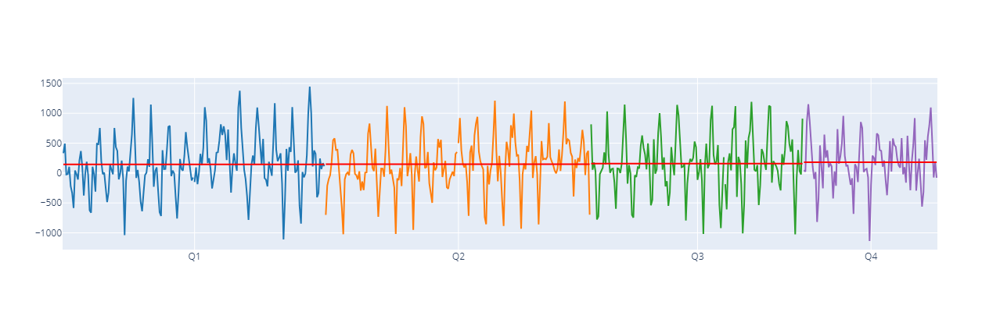

In [45]:
quarter_plot(df_timestamp, col='Y', key= 'ID', enable_plotly=True, width=600, height=400)

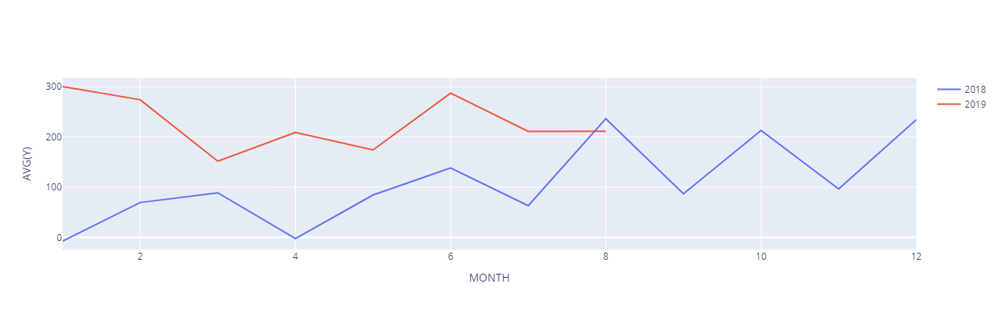

In [46]:
seasonal_plot(df_timestamp, col='Y', key='ID', enable_plotly=True, width=600, height=400)

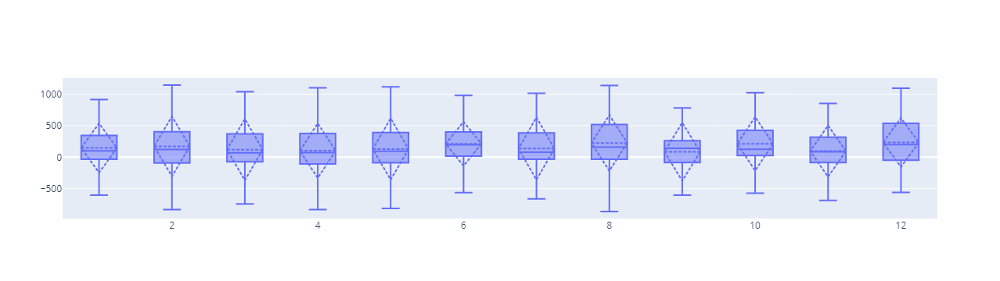

In [47]:
timeseries_box_plot(df_timestamp, col='Y', key= 'ID', enable_plotly=True)

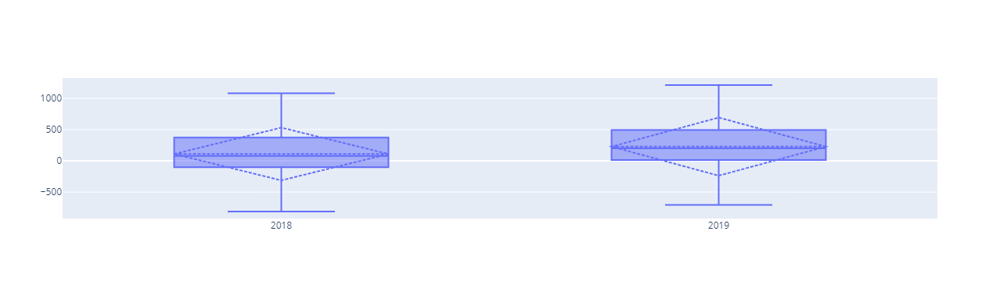

In [48]:
timeseries_box_plot(df_timestamp, col='Y', key= 'ID', enable_plotly=True, cycle="YEAR")

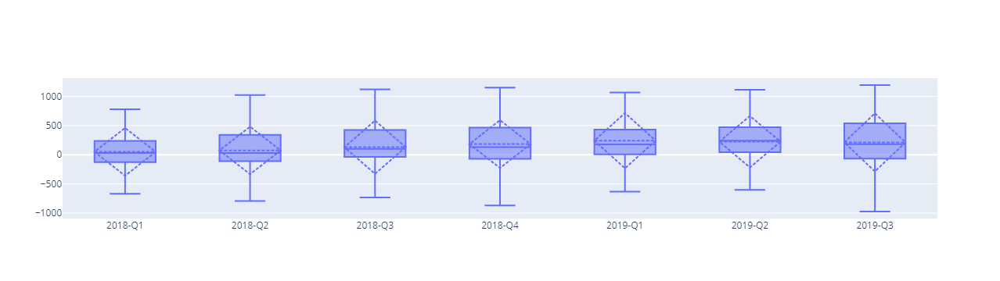

In [49]:
timeseries_box_plot(df_timestamp, col='Y', key= 'ID', enable_plotly=True, cycle="QUARTER")

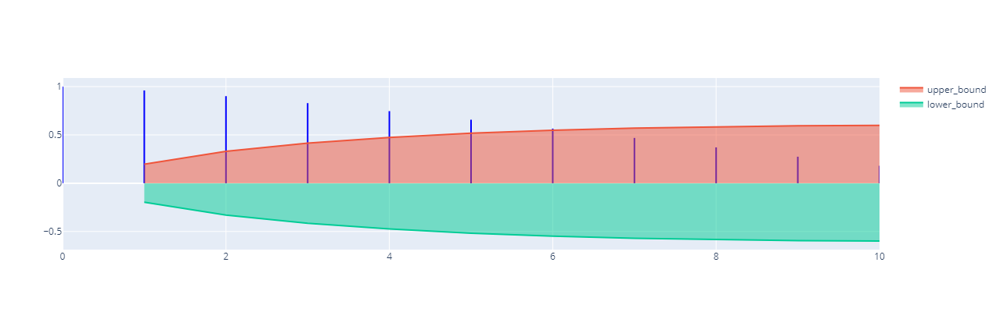

In [50]:
plot_acf(df, key='ID', col='ts', method = 'fft', thread_ratio=0.4, enable_plotly=True, width=600, height=400)

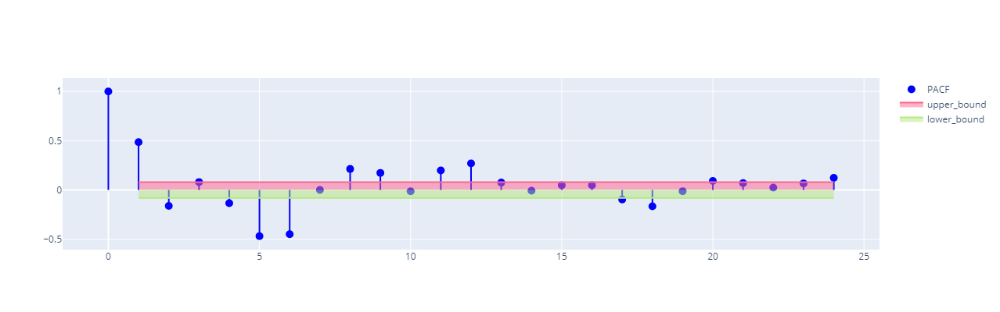

In [51]:
plot_pacf(df_timestamp, col='Y', key= 'ID', thread_ratio=0.4, enable_plotly=True, width=600, height=400)

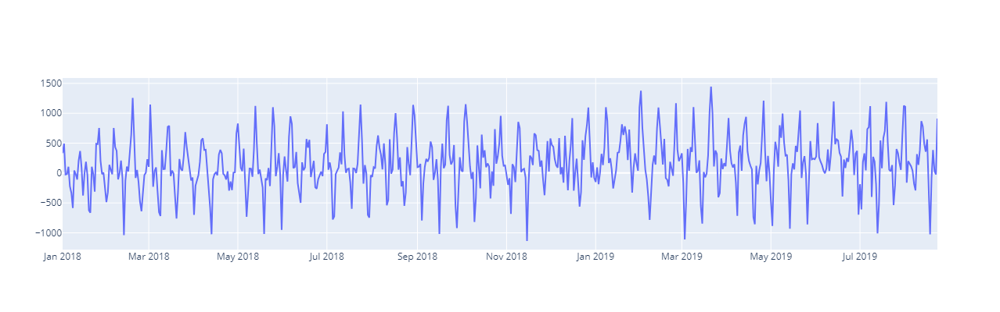

In [52]:
plot_time_series_outlier(df_timestamp, col='Y', key= 'ID', enable_plotly=True, width=600, height=400)

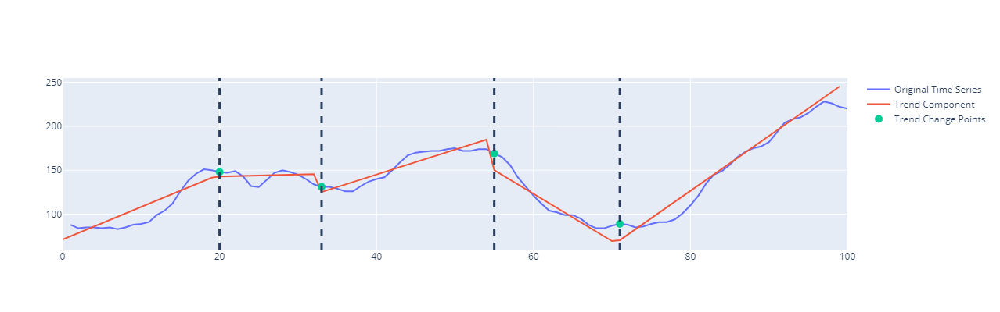

In [53]:
from hana_ml.algorithms.pal.tsa.changepoint import BCPD
bcpd = BCPD(max_tcp=5, max_scp=0, random_seed=1, max_iter=1000)
plot_change_points(df, key='ID', col='ts', cp_object=bcpd, enable_plotly=True, width=600, height=400)

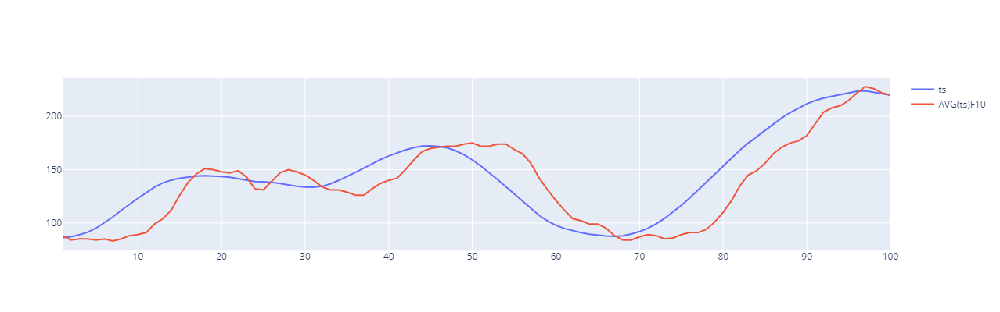

In [54]:
plot_moving_average(df, key='ID', col='ts', rolling_window=10, compare=True, enable_plotly=True, width=600, height=400)

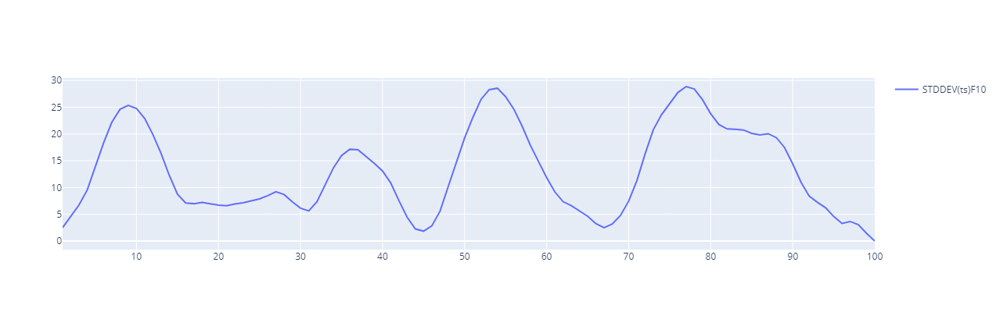

In [55]:
plot_rolling_stddev(df, key='ID', col='ts', rolling_window=10, enable_plotly=True, width=600, height=400)

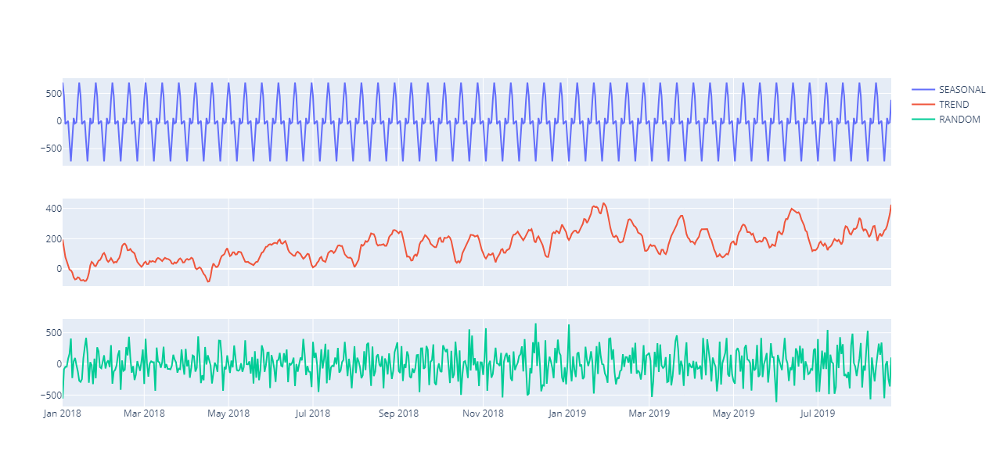

In [56]:
plot_seasonal_decompose(data=df_timestamp, col='Y', key= 'ID', enable_plotly=True, width=1000, height=600)

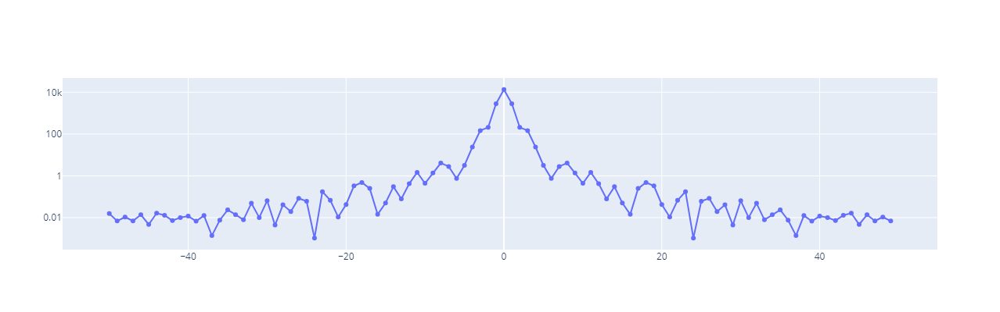

In [57]:
plot_psd(data=df, col="ts",  key="ID", sampling_rate=100.0, window="hamming", freq_range="two_sides", title="Periodogram", enable_plotly=True, width=600, height=400, semilogy=True)

## 2.18 Misc enhancements
### Massive mode for IsolationForest

In [60]:
data = [['100', 100, 0, -2, -1],
        ['100', 100, 1, -1, -1],
        ['100', 100, 2, -1, -2],
        ['100', 100, 3,  1,  1],
        ['100', 100, 4,  1,  2],
        ['100', 100, 5,  2,  1],
        ['100', 100, 6,  6,  3],
        ['100', 100, 7, -4,  7],
        ['200', 200, 0, -2, -1],
        ['200', 200, 1, -1, -1],
        ['200', 200, 2, -1, -2],
        ['200', 200, 3,  1,  1],
        ['200', 200, 4,  1,  2],
        ['200', 200, 5,  2,  1],
        ['200', 200, 6,  6,  3],
        ['200', 200, 7, -4,  7]]
col_name = ['GROUP_ID_NAR', 'GROUP_ID_INT', 'ID', 'F1', 'F2']
df = pd.DataFrame(data=data,columns=col_name)

df_m = dataframe.create_dataframe_from_pandas(connection_context=cc, 
                                    pandas_df=df,
                                    table_name='DATA_ISOLATION_FOREST_TBL_NOTEBOOK_MASSIVE', 
                                    force=True, 
                                    replace=True)

100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 18.32it/s]


In [61]:
from hana_ml.algorithms.pal.preprocessing import IsolationForest

mif = IsolationForest(random_state=2, thread_ratio=0, massive=True)
mif.fit(data=df_m, key="ID", group_key="GROUP_ID_NAR", features=['F1', 'F2'])
mif.model_.collect()

,GROUP_ID,TREE_INDEX,MODEL_CONTENT
0,100,0,"{""NS"":8,""NF"":2,""FX"":[0,1],""1"":{""SF"":0,""SV"":5.5..."
1,100,1,"{""NS"":8,""NF"":2,""FX"":[0,1],""1"":{""SF"":0,""SV"":5.5..."
2,100,2,"{""NS"":8,""NF"":2,""FX"":[1,0],""1"":{""SF"":0,""SV"":4.6..."
3,100,3,"{""NS"":8,""NF"":2,""FX"":[1,0],""1"":{""SF"":0,""SV"":4.6..."
4,100,4,"{""NS"":8,""NF"":2,""FX"":[1,0],""1"":{""SF"":0,""SV"":5.3..."
...,...,...,...
195,200,95,"{""NS"":8,""NF"":2,""FX"":[1,0],""1"":{""SF"":0,""SV"":5.1..."
196,200,96,"{""NS"":8,""NF"":2,""FX"":[1,0],""1"":{""SF"":1,""SV"":1.6..."
197,200,97,"{""NS"":8,""NF"":2,""FX"":[1,0],""1"":{""SF"":1,""SV"":1.6..."
198,200,98,"{""NS"":8,""NF"":2,""FX"":[0,1],""1"":{""SF"":1,""SV"":4.7..."


In [62]:
result = mif.predict(data=df_m, key="ID", group_key="GROUP_ID_NAR", features=['F1', 'F2'], contamination=0.2)
result[0].collect()

,GROUP_ID,ID,SCORE,LABEL
0,100,0,0.446897,1
1,100,1,0.411048,1
2,100,2,0.498931,1
3,100,3,0.407796,1
4,100,4,0.423264,1
5,100,5,0.443270,1
6,100,6,0.619513,-1
7,100,7,0.638874,-1
8,200,0,0.446897,1
9,200,1,0.411048,1


## 2.19 Misc. enhancements 
### QuantileTransform

In [63]:
walmart_data = DataSets.load_walmart_data(cc).dropna()

100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.62it/s]


In [64]:
walmart_data.head(5).collect()

,ITEM_IDENTIFIER,ITEM_WEIGHT,ITEM_FAT_CONTENT,ITEM_VISIBILITY,ITEM_TYPE,ITEM_MRP,OUTLET_IDENTIFIER,OUTLET_ESTABLISHMENT_YEAR,OUTLET_SIZE,OUTLET_LOCATION_IDENTIFIER,OUTLET_TYPE,ITEM_OUTLET_SALES
0,FDU49,19.5,Regular,0.030742,Canned,85.5540,OUT049,1999,Medium,Tier 1,Supermarket Type1,1211.7560
1,FDP33,18.7,Low Fat,0.089198,Snack Foods,257.3672,OUT013,1987,High,Tier 3,Supermarket Type1,2045.3376
2,FDT15,0.0,Regular,0.074730,Meat,183.7950,OUT019,1985,Small,Tier 1,Grocery Store,549.2850
3,FDT49,7.0,Low Fat,0.151280,Canned,107.0280,OUT013,1987,High,Tier 3,Supermarket Type1,2876.2560
4,FDK02,12.5,Low Fat,0.112203,Canned,121.1440,OUT035,2004,Small,Tier 2,Supermarket Type1,1438.1280


In [66]:
from hana_ml.algorithms.pal.preprocessing import QuantileTransform

qt = QuantileTransform(output_distribution='uniform',
                       num_quantiles=200)
qt.fit(walmart_data, key='ITEM_IDENTIFIER', features=['ITEM_WEIGHT'])

qt.transform(walmart_data, key='ITEM_IDENTIFIER').collect()

,ITEM_IDENTIFIER,ITEM_WEIGHT,ITEM_FAT_CONTENT,ITEM_VISIBILITY,ITEM_TYPE,ITEM_MRP,OUTLET_IDENTIFIER,OUTLET_ESTABLISHMENT_YEAR,OUTLET_SIZE,OUTLET_LOCATION_IDENTIFIER,OUTLET_TYPE,ITEM_OUTLET_SALES
0,FDU49,0.924623,Regular,0.030742,Canned,85.5540,OUT049,1999.0,Medium,Tier 1,Supermarket Type1,1211.7560
1,FDP33,0.889447,Low Fat,0.089198,Snack Foods,257.3672,OUT013,1987.0,High,Tier 3,Supermarket Type1,2045.3376
2,FDT15,0.000000,Regular,0.074730,Meat,183.7950,OUT019,1985.0,Small,Tier 1,Grocery Store,549.2850
3,FDT49,0.331658,Low Fat,0.151280,Canned,107.0280,OUT013,1987.0,High,Tier 3,Supermarket Type1,2876.2560
4,FDK02,0.613065,Low Fat,0.112203,Canned,121.1440,OUT035,2004.0,Small,Tier 2,Supermarket Type1,1438.1280
...,...,...,...,...,...,...,...,...,...,...,...,...
6108,FDU58,0.309625,Regular,0.029130,Snack Foods,188.4898,OUT018,2009.0,Medium,Tier 3,Supermarket Type2,4677.2450
6109,FDG57,0.701070,Low Fat,0.072285,Fruits and Vegetables,49.8034,OUT035,2004.0,Small,Tier 2,Supermarket Type1,631.8442
6110,FDL09,0.929648,Regular,0.128012,Snack Foods,166.8816,OUT035,2004.0,Small,Tier 2,Supermarket Type1,1845.5976
6111,FDQ25,0.422904,Regular,0.028392,Canned,173.9422,OUT018,2009.0,Medium,Tier 3,Supermarket Type2,4138.6128


### Boost dataset report with new PAL describe function

In [67]:
from hana_ml.algorithms.pal.utility import DataSets
full_df, _, _, _ = DataSets.load_bank_data(cc)

100%|████████████████████████████████████████████████████████████████████████████████████| 5/5 [00:04<00:00,  1.05it/s]


In [68]:
full_df.shape

[41188, 22]

In [69]:
full_df.columns

['ID',
 'AGE',
 'JOB',
 'MARITAL',
 'EDUCATION',
 'DBM_DEFAULT',
 'HOUSING',
 'LOAN',
 'CONTACT',
 'DBM_MONTH',
 'DAY_OF_WEEK',
 'DURATION',
 'CAMPAIGN',
 'PDAYS',
 'PREVIOUS',
 'POUTCOME',
 'EMP_VAR_RATE',
 'CONS_PRICE_IDX',
 'CONS_CONF_IDX',
 'EURIBOR3M',
 'NREMPLOYED',
 'LABEL']

Analyzing dataset...:   0%|                                                                      | 0/6 [00:00<?, ?it/s]

Analyzing dataset...:  17%|██████████▎                                                   | 1/6 [00:00<00:00,  5.59it/s]


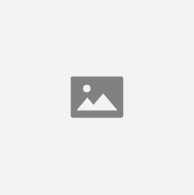

In [70]:
from hana_ml.visualizers.unified_report import UnifiedReport

UnifiedReport(full_df).build(key="ID").display()

### DataFrame Enhancement

In [ ]:
#Added description and description_ext property to dataframe.

In [71]:
full_df.description

(('ID', 3, 10, 10, 10, 0, True),
 ('AGE', 3, 10, 10, 10, 0, True),
 ('JOB', 9, 5000, 5000, 5000, 0, True),
 ('MARITAL', 9, 5000, 5000, 5000, 0, True),
 ('EDUCATION', 9, 5000, 5000, 5000, 0, True),
 ('DBM_DEFAULT', 9, 5000, 5000, 5000, 0, True),
 ('HOUSING', 9, 5000, 5000, 5000, 0, True),
 ('LOAN', 9, 5000, 5000, 5000, 0, True),
 ('CONTACT', 9, 5000, 5000, 5000, 0, True),
 ('DBM_MONTH', 9, 5000, 5000, 5000, 0, True),
 ('DAY_OF_WEEK', 9, 5000, 5000, 5000, 0, True),
 ('DURATION', 3, 10, 10, 10, 0, True),
 ('CAMPAIGN', 3, 10, 10, 10, 0, True),
 ('PDAYS', 3, 10, 10, 10, 0, True),
 ('PREVIOUS', 3, 10, 10, 10, 0, True),
 ('POUTCOME', 9, 5000, 5000, 5000, 0, True),
 ('EMP_VAR_RATE', 7, 15, 15, 15, 0, True),
 ('CONS_PRICE_IDX', 7, 15, 15, 15, 0, True),
 ('CONS_CONF_IDX', 7, 15, 15, 15, 0, True),
 ('EURIBOR3M', 7, 15, 15, 15, 0, True),
 ('NREMPLOYED', 7, 15, 15, 15, 0, True),
 ('LABEL', 9, 5000, 5000, 5000, 0, True))

In [72]:
#Added :func:`~hana_ml.dataframe.DataFrame.auto_cast`.

In [73]:
full_df.get_table_structure()

{'ID': 'INT',
 'AGE': 'INT',
 'JOB': 'VARCHAR(5000)',
 'MARITAL': 'VARCHAR(5000)',
 'EDUCATION': 'VARCHAR(5000)',
 'DBM_DEFAULT': 'VARCHAR(5000)',
 'HOUSING': 'VARCHAR(5000)',
 'LOAN': 'VARCHAR(5000)',
 'CONTACT': 'VARCHAR(5000)',
 'DBM_MONTH': 'VARCHAR(5000)',
 'DAY_OF_WEEK': 'VARCHAR(5000)',
 'DURATION': 'INT',
 'CAMPAIGN': 'INT',
 'PDAYS': 'INT',
 'PREVIOUS': 'INT',
 'POUTCOME': 'VARCHAR(5000)',
 'EMP_VAR_RATE': 'DOUBLE',
 'CONS_PRICE_IDX': 'DOUBLE',
 'CONS_CONF_IDX': 'DOUBLE',
 'EURIBOR3M': 'DOUBLE',
 'NREMPLOYED': 'DOUBLE',
 'LABEL': 'VARCHAR(5000)'}

In [74]:
full_df = full_df.auto_cast({"VARCHAR(5000)": "VARCHAR(500)"})

In [75]:
full_df.get_table_structure()

{'ID': 'INT',
 'AGE': 'INT',
 'JOB': 'VARCHAR(500)',
 'MARITAL': 'VARCHAR(500)',
 'EDUCATION': 'VARCHAR(500)',
 'DBM_DEFAULT': 'VARCHAR(500)',
 'HOUSING': 'VARCHAR(500)',
 'LOAN': 'VARCHAR(500)',
 'CONTACT': 'VARCHAR(500)',
 'DBM_MONTH': 'VARCHAR(500)',
 'DAY_OF_WEEK': 'VARCHAR(500)',
 'DURATION': 'INT',
 'CAMPAIGN': 'INT',
 'PDAYS': 'INT',
 'PREVIOUS': 'INT',
 'POUTCOME': 'VARCHAR(500)',
 'EMP_VAR_RATE': 'DOUBLE',
 'CONS_PRICE_IDX': 'DOUBLE',
 'CONS_CONF_IDX': 'DOUBLE',
 'EURIBOR3M': 'DOUBLE',
 'NREMPLOYED': 'DOUBLE',
 'LABEL': 'VARCHAR(500)'}

In [76]:
#Added :func:`~hana_ml.dataframe.DataFrame.summary`.

In [77]:
from timeit import time
from IPython.display import display
start = time.time()
display(full_df.summary().collect())
print("It takes {} s".format(time.time() - start))

,VARIABLE_NAME,"CI for mean, lower bound","CI for mean, upper bound",kurtosis,lower quartile,max,mean,median,min,nulls,skewness,standard deviation,trimmed mean,unique,upper quartile,valid observations,variance
0,CONS_PRICE_IDX,93.570074,93.581255,-0.829854,93.075,94.767,93.575664,93.749,92.201,0.0,-0.230879,0.578840,93.590621,26.0,93.994,41188.0,3.350558e-01
1,LOAN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,3.0,NaN,41188.0,NaN
2,EDUCATION,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,8.0,NaN,41188.0,NaN
3,HOUSING,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,3.0,NaN,41188.0,NaN
4,CONTACT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,2.0,NaN,41188.0,NaN
5,POUTCOME,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,3.0,NaN,41188.0,NaN
6,EMP_VAR_RATE,0.066714,0.097057,-1.062648,-1.800,1.400,0.081886,1.100,-3.400,0.0,-0.724069,1.570960,0.189207,10.0,1.400,41188.0,2.467915e+00
7,LABEL,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,2.0,NaN,41188.0,NaN
8,PDAYS,960.670317,964.280591,22.226619,999.000,999.000,962.475454,999.000,0.000,0.0,-4.922011,186.910907,999.000000,27.0,999.000,41188.0,3.493569e+04
9,DBM_DEFAULT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,3.0,NaN,41188.0,NaN


It takes 1.082019329071045 s


In [78]:
#Enhanced operation, mutate and filter in DataFrame.

In [79]:
(full_df.DURATION/(full_df.ID+1) + full_df.PDAYS).collect()

,((DURATION/(ID+1))+PDAYS)
0,1260
1,1073.5
2,1074.333333
3,1036.75
4,1060.4
...,...
41183,999.010464
41184,999.003645
41185,999.002989
41186,999.001678


In [80]:
##new columns age_plus_2, age_minus_2
age = full_df.AGE
full_df.mutate(age_minus_2=age-2, age_plus_2=age+2)[["AGE", "age_minus_2", "age_plus_2"]].collect()

,AGE,age_minus_2,age_plus_2
0,56,54,58
1,57,55,59
2,37,35,39
3,40,38,42
4,56,54,58
...,...,...,...
41183,31,29,33
41184,69,67,71
41185,69,67,71
41186,57,55,59


In [81]:
full_df.filter((full_df.ID-30000==0) | (full_df.AGE.isin([29]))).collect()

,ID,AGE,JOB,MARITAL,EDUCATION,DBM_DEFAULT,HOUSING,LOAN,CONTACT,DBM_MONTH,...,CAMPAIGN,PDAYS,PREVIOUS,POUTCOME,EMP_VAR_RATE,CONS_PRICE_IDX,CONS_CONF_IDX,EURIBOR3M,NREMPLOYED,LABEL
0,12,29,blue-collar,single,high.school,no,no,yes,telephone,may,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
1,330,29,services,single,high.school,no,yes,no,telephone,may,...,2,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
2,397,29,blue-collar,divorced,basic.4y,no,no,no,telephone,may,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
3,473,29,admin.,married,university.degree,unknown,yes,no,telephone,may,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
4,641,29,admin.,married,high.school,no,yes,no,telephone,may,...,3,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1449,41068,29,admin.,single,high.school,no,yes,no,telephone,nov,...,1,6,1,success,-1.1,94.767,-50.8,1.050,4963.6,no
1450,41098,29,student,single,high.school,no,yes,yes,cellular,nov,...,1,3,3,success,-1.1,94.767,-50.8,1.050,4963.6,yes
1451,41117,29,technician,single,professional.course,no,no,no,cellular,nov,...,2,1,1,success,-1.1,94.767,-50.8,1.046,4963.6,yes
1452,41143,29,technician,single,professional.course,no,no,yes,cellular,nov,...,1,6,2,success,-1.1,94.767,-50.8,1.040,4963.6,no


### Model Storage Enhancement

In [82]:
#Enhanced model list in model storage by adding partial info display option.

In [83]:
from hana_ml.model_storage import ModelStorage
model_storage = ModelStorage(connection_context=cc)
model_storage.list_models(display_type='no_reports')#'complete', 'simple', 'no_reports'

,NAME,VERSION,LIBRARY,CLASS,JSON,TIMESTAMP,STORAGE_TYPE,MODEL_STORAGE_VER,SCHEDULE
0,Model Pipeline,1,PAL,hana_ml.algorithms.pal.auto_ml.AutomaticClassi...,"{""model_attributes"": {""scorings"": null, ""gener...",2024-11-22 15:13:29,default,1,"{""schedule"": {""status"": ""inactive"", ""schedule_..."


## 2.20 Exploratory Data Analysis and Visualizations

### Bubble Plot & Parallel Co-ordinate Plot

In [84]:
import numpy as np
import random
import pandas as pd
from hana_ml.dataframe import create_dataframe_from_pandas

num_point=100
x = np.random.rand(num_point)
y = np.random.rand(num_point)
w = np.random.rand(num_point)
z = np.random.rand(num_point)*1000
cate = [random.randrange(1, 3, 1) for i in range(num_point)]
label = [random.randrange(1, 5, 1) for i in range(num_point)]
color = np.random.rand(num_point)

content = {'X':x, 'Y':y, 'S':z, 'W':w, 'cate':cate, 'label':label}
df_pd=pd.DataFrame(content)
print(df_pd.dtypes)
df = create_dataframe_from_pandas(cc, 
                                  pandas_df=df_pd,
                                  table_name='DATA', 
                                  force=True, 
                                  replace=True)
df_new = df.cast({"cate":"NVARCHAR(20)"})
full_set, training_set, validation_set, test_set = DataSets.load_iris_data(cc)

X        float64
Y        float64
S        float64
W        float64
cate       int64
label      int64
dtype: object


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 16.99it/s]


Table IRIS_DATA_FULL_TBL exists.


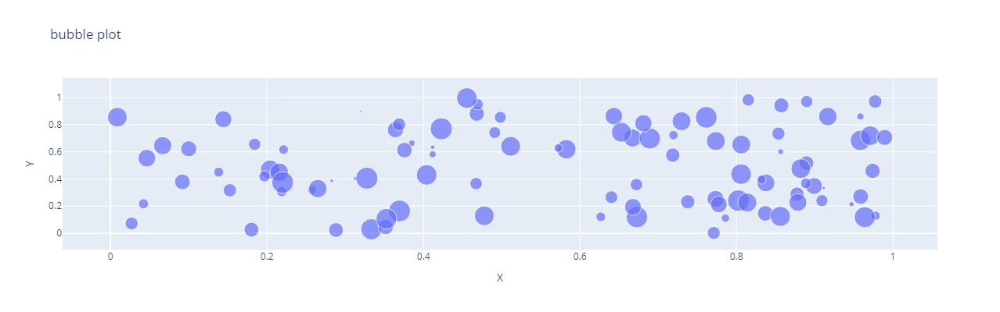

In [85]:
from hana_ml.visualizers.eda import parallel_coordinates, bubble_plot

fig = bubble_plot(df_new, x='X', y='Y', size='S', title="bubble plot", width=600, height=400)
fig.show()

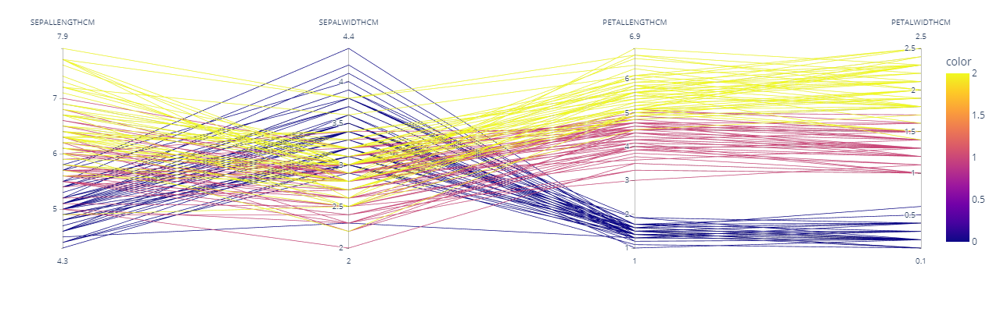

In [86]:
fig = parallel_coordinates(data=full_set.deselect("ID"), label='SPECIES', 
                          cols=['SEPALLENGTHCM', 'SEPALWIDTHCM', 'PETALLENGTHCM', 'PETALWIDTHCM'],
                          width=600, height=400)
fig.show()

## 2.21 Financial analysis functions

### New Hull White simulation 
A trending financial math function used in modeling interest rates, vital in modeling of various financial instruments and risk.

In [87]:
#Hull White Simulation
import pandas as pd
from hana_ml.dataframe import ConnectionContext, create_dataframe_from_pandas

data_list = [(0, 0.075), (1,  0.16),(2,  0.13),(3,  0.28),(4,  0.47),
            (5,  0.68),(6,  0.15),(7,  0.28),(8,  0.54),(9,  0.24),
            (10, 0.02),(11, 0.43),(12, 0.12),(13, 0.87),(14, 0.32),
            (15, 0.81),(16, 0.68),(17, 0.22),(18, 0.04),(19, 0.67),
            (20, 0.2 ),(21, 0.97),(22, 0.89),(23, 0.25),(24, 0.72),
            (25, 0.33),(26, 0.07),(27,  0.6),(28, 0.97),(29, 0.83)]

pf = pd.DataFrame(data_list, columns=['Year', 'Rate'])

df = create_dataframe_from_pandas(connection_context=cc, pandas_df=pf, table_name='HULL_WHITE_SIMULATION', force=True)

100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 18.88it/s]


In [88]:
from hana_ml.algorithms.pal.tsa.hull_white import hull_white_simulate


result = hull_white_simulate(df,
                             key='Year',
                             endog = 'Rate',
                             num_simulation_paths=5000,
                             random_seed=1,
                             mean_reversion_speed=0.1,
                             volatility=0.01,
                             time_increment=0.083,
                             confidence_level=0.95,
                             initial_value=0.0)
print(result.shape)
print(result.collect())

[30, 5]
    ID      MEAN  VARIANCE  LOWER_BOUND  UPPER_BOUND
0    0  0.006255  0.000008     0.000666     0.011843
1    1  0.019503  0.000017     0.011505     0.027502
2    2  0.030117  0.000024     0.020454     0.039781
3    3  0.053127  0.000032     0.042032     0.064221
4    4  0.091713  0.000041     0.079137     0.104289
5    5  0.147416  0.000049     0.133700     0.161132
6    6  0.158675  0.000057     0.143915     0.173436
7    7  0.180587  0.000064     0.164938     0.196236
8    8  0.223935  0.000071     0.207382     0.240487
9    9  0.241954  0.000079     0.224567     0.259341
10  10  0.241629  0.000086     0.223421     0.259837
11  11  0.275293  0.000094     0.256340     0.294247
12  12  0.282939  0.000099     0.263444     0.302433
13  13  0.352883  0.000106     0.332702     0.373065
14  14  0.376554  0.000112     0.355779     0.397328
15  15  0.440698  0.000117     0.419461     0.461935
16  16  0.493457  0.000124     0.471625     0.515289
17  17  0.507683  0.000131     0.48526

### Benford Analysis 
A trending algorithm used to detect anomalies in numerical datasets like e.g. financial transactions

In [89]:
#Benford Analysis
data_list = [(0, 1.1, 1, 1, 'A'),
                (1, 1.2, 1, 2, 'A'),
                (2, 1.3, 2, 3, 'B'),
                (3, 1.4, 3, 1, 'C'),
                (4, 1.5, 5, 2, 'B'),
                (5, 1.6, 8, 3, 'A'),
                (6, 2.7, 13, 1, 'B'),
                (7, 2.72, 21, 2, 'B'),
                (8, 2.74, 34, 3, 'A'),
                (9, 2.94, 55, 1, 'C'),
                (10, 3.15, 89, 2, 'C'),
                (11, 3.45, 144, 3, 'B'),
                (12, 3.75, 233, 1, 'A'),
                (13, 4.14, 377, 2, 'C'),
                (14, 4.63, 610, 3, 'A'),
                (15, 5.03, 987, 1, 'B'),
                (16, 0.6, 1597, 2, 'C'),
                (17, 75.01, 2584, 3, 'A'),
                (18, 82.3, 4181, 1, 'B'),
                (19, 91.4, 6765, 2, 'C')]
pf = pd.DataFrame(data_list, columns=['ID', 'X1', 'X2', 'X3', 'X4'])

df = create_dataframe_from_pandas(connection_context=cc, pandas_df=pf, table_name='#PAL_BENFORD_DATA_TBL', force=True)

100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 20.39it/s]


In [90]:
from hana_ml.algorithms.pal.stats import benford_analysis


benford_res = benford_analysis(data=df,
                                key='ID',
                                sign='positive',
                                number_of_digits=2,
                                categorical_variable='X3',
                                discrete=False)
print(benford_res[0].collect())
print(benford_res[1].collect())
print(benford_res[2].collect())
print(benford_res[3].collect())

  COLUMN_NAME       MAD MAD_CONFORMITY  DISTORTION
0          X1  0.015358  Nonconformity  112.153866
1          X2  0.015513  Nonconformity    9.353352
    COLUMN_NAME  DIGITS  DATA_DISTRIBUTION  SECOND_ORDER_DISTRIBUTION  \
0            X1      10               0.00                   0.263158   
1            X1      11               0.05                   0.052632   
2            X1      12               0.05                   0.000000   
3            X1      13               0.05                   0.000000   
4            X1      14               0.05                   0.000000   
..          ...     ...                ...                        ...   
175          X2      95               0.00                   0.000000   
176          X2      96               0.00                   0.000000   
177          X2      97               0.00                   0.000000   
178          X2      98               0.05                   0.055556   
179          X2      99               0.00  

## 2.22 Misc enhancements

### New Machine Learning model card management
Model cards are an important documentation framework for understanding, sharing, and improving machine learning models. A model card is a short document that provides key information about a machine learning model. Model cards increase transparency in documentating various aspects of a ML model, for example incl. input data schema. For more information about model cards see [huggingface.co/model-cards](https://huggingface.co/blog/model-cards).

In [92]:
from hana_ml.algorithms.pal.model_cards import create_model_card

model_card = create_model_card(auto_c)

In [93]:
print(model_card)

---
language: en
license: SAP Developer License Agreement
library_name: hana_ml.algorithms.pal.auto_ml.AutomaticClassification
datasets:
  training_data: 'SELECT a.* FROM #PAL_PARTITION_DATA_TBL_2FEAB068_A8DB_11EF_BD9E_F47B09A01846
    a inner join #PAL_PARTITION_RESULT_TBL_2FEAB068_A8DB_11EF_BD9E_F47B09A01846 b        on
    a."ID" = b."ID" where b."PARTITION_TYPE" = 1'
  training_data_signature:
    ID: INT
    PREGNANCIES: INT
    GLUCOSE: INT
    SKINTHICKNESS: INT
    INSULIN: DOUBLE
    BMI: DOUBLE
    AGE: INT
    CLASS: INT
metrics:
  model_metrics: '{"ACCURACY":0.6719070403280929,"AUC":0.7511681221789327,"F1_SCORE_0":0.7152771845578865,"F1_SCORE_1":0.5953294845789775,"KAPPA":0.33099825461510115,"LAYERS":2.0,"MCC":0.34802442491580479,"PRECISION_0":0.8000307878388036,"PRECISION_1":0.5462139386011412,"RECALL_0":0.6676734693877551,"RECALL_1":0.6825396825396826,"SUPPORT_0":49.2,"SUPPORT_1":27.6,"TIME":0.0124}'
model_name: Model Pipeline
model_version: 1
---

# Model Card for Model 

In [95]:
# Store the HANA ML model using ModelStorage and retrieve model card information from Model Storage
from hana_ml.model_storage import ModelStorage

model_storage = ModelStorage(cc)

model_storage.clean_up()

auto_c.name = "Diabetes Classifier AutoML Model"
auto_c.version = 1

model_storage.save_model(model=auto_c)

In [96]:
model_card = model_storage.get_model_card(name="Diabetes Classifier AutoML Model", version=1)
model_card.data

{'language': 'en', 'license': 'SAP Developer License Agreement', 'library_name': 'hana_ml.algorithms.pal.auto_ml.AutomaticClassification', 'datasets': {'training_data': 'SELECT a.* FROM #PAL_PARTITION_DATA_TBL_2FEAB068_A8DB_11EF_BD9E_F47B09A01846 a inner join #PAL_PARTITION_RESULT_TBL_2FEAB068_A8DB_11EF_BD9E_F47B09A01846 b        on a."ID" = b."ID" where b."PARTITION_TYPE" = 1', 'training_data_signature': {'ID': 'INT', 'PREGNANCIES': 'INT', 'GLUCOSE': 'INT', 'SKINTHICKNESS': 'INT', 'INSULIN': 'DOUBLE', 'BMI': 'DOUBLE', 'AGE': 'INT', 'CLASS': 'INT'}}, 'metrics': {'model_metrics': '{"ACCURACY":0.6719070403280929,"AUC":0.7511681221789327,"F1_SCORE_0":0.7152771845578865,"F1_SCORE_1":0.5953294845789775,"KAPPA":0.33099825461510115,"LAYERS":2.0,"MCC":0.34802442491580479,"PRECISION_0":0.8000307878388036,"PRECISION_1":0.5462139386011412,"RECALL_0":0.6676734693877551,"RECALL_1":0.6825396825396826,"SUPPORT_0":49.2,"SUPPORT_1":27.6,"TIME":0.0124}'}, 'model_name': 'Model Pipeline', 'model_version':

In [98]:
# Retrieve the model card information from a model loaded from Model Storage
from hana_ml.algorithms.pal.model_cards import parse_model_card

my_model = model_storage.load_model(name="Diabetes Classifier AutoML Model", version=1)
my_model_card = parse_model_card(my_model.model_card_)

my_model_card.data

{'language': 'en', 'license': 'SAP Developer License Agreement', 'library_name': 'hana_ml.algorithms.pal.auto_ml.AutomaticClassification', 'datasets': {'training_data': 'SELECT a.* FROM #PAL_PARTITION_DATA_TBL_2FEAB068_A8DB_11EF_BD9E_F47B09A01846 a inner join #PAL_PARTITION_RESULT_TBL_2FEAB068_A8DB_11EF_BD9E_F47B09A01846 b        on a."ID" = b."ID" where b."PARTITION_TYPE" = 1', 'training_data_signature': {'ID': 'INT', 'PREGNANCIES': 'INT', 'GLUCOSE': 'INT', 'SKINTHICKNESS': 'INT', 'INSULIN': 'DOUBLE', 'BMI': 'DOUBLE', 'AGE': 'INT', 'CLASS': 'INT'}}, 'metrics': {'model_metrics': '{"ACCURACY":0.6719070403280929,"AUC":0.7511681221789327,"F1_SCORE_0":0.7152771845578865,"F1_SCORE_1":0.5953294845789775,"KAPPA":0.33099825461510115,"LAYERS":2.0,"MCC":0.34802442491580479,"PRECISION_0":0.8000307878388036,"PRECISION_1":0.5462139386011412,"RECALL_0":0.6676734693877551,"RECALL_1":0.6825396825396826,"SUPPORT_0":49.2,"SUPPORT_1":27.6,"TIME":0.0124}'}, 'model_name': 'Model Pipeline', 'model_version':

### New Dataset report style

In [99]:
# Upload a dataset from local CSV-file 
import pandas as pd
hdf = dataframe.create_dataframe_from_pandas(cc,
                                            pd.read_csv("./SBOOK_TICKETPRICE.csv"),
                                            table_name="SBOOK_TICKETPRICE",
                                            force=True)
sbook_ticketprice = hdf.add_id(id_col='ID').deselect('INVOICE')
#print(sbook_ticketprice.select_statement)
#print(sbook_ticketprice.columns)

100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:04<00:00,  4.02s/it]


Analyzing dataset...:   0%|                                                                      | 0/6 [00:00<?, ?it/s]

Analyzing dataset...:  17%|██████████▎                                                   | 1/6 [00:00<00:00,  5.57it/s]


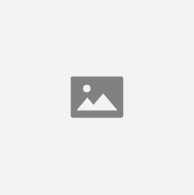

In [100]:
# Dataset report updated, style alignment with model report
from hana_ml.visualizers.unified_report import UnifiedReport

UnifiedReport(sbook_ticketprice).build(key='ID').display()

### Text Processing, model-based text classification

In [101]:
# Preparing text classification simple sample data
data = pd.DataFrame({"ID" : ['doc1', 'doc2', 'doc3', 'doc4', 'doc5', 'doc6'],
                     "CONTENT" : ['term1 term2 term2 term3 term3 term3',
                                  'term2 term3 term3 term4 term4 term4',
                                  'term3 term4 term4 term5 term5 term5',
                                  'term3 term4 term4 term5 term5 term5 term5 term5 term5',
                                  'term4 term6',
                                  'term4 term6 term6 term6'],
                     "CATEGORY" : ['CATEGORY_1', 'CATEGORY_1', 'CATEGORY_2', 'CATEGORY_2', 'CATEGORY_3', 'CATEGORY_3']})
df_cloud = create_dataframe_from_pandas(connection_context=cc, pandas_df=data, table_name="TM_DEMO", force=True)
print(df_cloud.collect())

100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 16.29it/s]


     ID                                            CONTENT    CATEGORY
0  doc1                term1 term2 term2 term3 term3 term3  CATEGORY_1
1  doc2                term2 term3 term3 term4 term4 term4  CATEGORY_1
2  doc3                term3 term4 term4 term5 term5 term5  CATEGORY_2
3  doc4  term3 term4 term4 term5 term5 term5 term5 term...  CATEGORY_2
4  doc5                                        term4 term6  CATEGORY_3
5  doc6                            term4 term6 term6 term6  CATEGORY_3


In [102]:
from hana_ml.text.tm import TextClassificationWithModel
# Step 1. Initialize a TextClassification instance, including basic configs for TF-IDF vectorizer and RDT classifier
tc = TextClassificationWithModel(language='EN',  enable_stopwords=True, keep_numeric=False,
                                         allowed_list=["doc1", "doc2", "doc3", "doc4", "doc5", "doc6"])

# Step 2. Call TextClassification fit() method with training data as input, which is equivalent to applying TF-IDF analysis to the training data firstly, and then building an RDT classifier upon the TF-IDF vectorized training data. 
tc.fit(data=df_cloud, seed=1001, thread_ratio=0.5) 

# Step 3. Predict the labels the text data with the previously trained instance of TextClassification using TF-IDF vectorization and RDT classification.
prediction = tc.predict(data=df_cloud.drop(['CATEGORY']), thread_ratio=0.5, rdt_top_n=1) 


In [32]:
display(prediction.collect())


,ID,TARGET
0,doc2,CATEGORY_1
1,doc5,CATEGORY_3
2,doc3,CATEGORY_2
3,doc6,CATEGORY_3
4,doc1,CATEGORY_1
5,doc4,CATEGORY_2
